# Random Forest on Amazon fine food dataset

Data Source: https://www.kaggle.com/snap/amazon-fine-food-reviews

The Amazon Fine Food Reviews dataset consists of reviews of fine foods from Amazon.<br>

Number of reviews: 568,454<br>
Number of users: 256,059<br>
Number of products: 74,258<br>
Timespan: Oct 1999 - Oct 2012<br>
Number of Attributes/Columns in data: 10 

Attribute Information:

1. Id
2. ProductId - unique identifier for the product
3. UserId - unqiue identifier for the user
4. ProfileName
5. HelpfulnessNumerator - number of users who found the review helpful
6. HelpfulnessDenominator - number of users who indicated whether they found the review helpful or not
7. Score - rating between 1 and 5
8. Time - timestamp for the review
9. Summary - brief summary of the review
10. Text - text of the review

#### Objective:
To perform Random forest on different vectors like BOW, Tf-idf, Avg-W2vec & Tf-idf_W2vec.

In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

import re

import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

C:\Users\deepak\Anaconda3\lib\site-packages\gensim\utils.py:1209: UserWarning: detected Windows; aliasing chunkize to chunkize_serial
  warnings.warn("detected Windows; aliasing chunkize to chunkize_serial")


In [2]:
#Importing Train and test dataset
train_data=pd.read_csv("E:/Applied AI assignments/Amazon_fine_train_data.csv")
test_data=pd.read_csv("E:/Applied AI assignments/Amazon_fine_test_data.csv")

In [3]:
train_data=train_data.astype(str)
test_data=test_data.astype(str)

In [5]:
train_data.shape

(80000, 13)

In [6]:
train_data['Score'].value_counts()

positive    70407
negative     9593
Name: Score, dtype: int64

In [7]:
test_data.shape

(20000, 13)

In [8]:
test_data['Score'].value_counts()

positive    17322
negative     2678
Name: Score, dtype: int64

In [4]:
#Train data
y_train = train_data['Score']
x_train = train_data['CleanedText']

#Test data
y_test = test_data['Score']
x_test = test_data['CleanedText'] 

In [5]:
#Replacing Positive score with 0 and negative score with 1
y_train.replace('negative',1,inplace=True)
y_train.replace('positive',0,inplace=True)

y_test.replace('negative',1,inplace=True)
y_test.replace('positive',0,inplace=True)

In [6]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score
from sklearn.metrics import make_scorer
from sklearn.metrics import confusion_matrix
from sklearn.cross_validation import cross_val_score
from collections import Counter
from sklearn import cross_validation
from wordcloud import WordCloud
import matplotlib.pyplot as plt

C:\Users\deepak\Anaconda3\lib\site-packages\sklearn\cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


#### RandomizedSearchCV

In [10]:
n_estimators=list(range(100,1100,100))
max_depth=list(range(1,31,1))
min_samples_split=list(range(2,31,1))
min_samples_leaf=list(range(1,31,1))
weight=[None,'balanced']
T= TimeSeriesSplit(n_splits=5)

param_distributions = dict(n_estimators=n_estimators,max_depth=max_depth,min_samples_split=min_samples_split,min_samples_leaf=min_samples_leaf,class_weight=weight)
print(param_distributions)

# instantiate and fit the grid
grid = RandomizedSearchCV(RandomForestClassifier(), param_distributions, cv=T, scoring='f1', n_iter=30,return_train_score=False,n_jobs=-1)

{'n_estimators': [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000], 'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30], 'min_samples_split': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30], 'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30], 'class_weight': [None, 'balanced']}


#### Binary Bow

In [13]:
count_vect = CountVectorizer(binary=True)

#Train data
vocabulary = count_vect.fit(x_train) #in scikit-learn
Bow_x_train= count_vect.transform(x_train)
print("the type of count vectorizer ",type(Bow_x_train))
print("the shape of out text BOW vectorizer ",Bow_x_train.get_shape())
print("the number of unique words ", Bow_x_train.get_shape()[1])

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text BOW vectorizer  (80000, 33433)
the number of unique words  33433


In [14]:
#Test data
Bow_x_test = count_vect.transform(x_test)
print("the type of count vectorizer ",type(Bow_x_test))
print("the shape of out text BOW vectorizer ",Bow_x_test.get_shape())
print("the number of unique words ", Bow_x_test.get_shape()[1])

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text BOW vectorizer  (20000, 33433)
the number of unique words  33433


In [21]:
grid.fit(Bow_x_train, y_train)

# examine the best model
print(grid.best_score_)
print(grid.best_params_)

0.6197538140083009
{'n_estimators': 1000, 'min_samples_split': 18, 'min_samples_leaf': 1, 'max_depth': 23, 'class_weight': 'balanced'}


Text(0,0.5,'Cross-Validated Error')

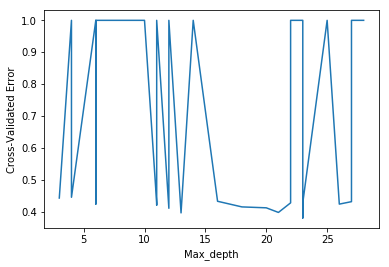

In [22]:
#Plotting Max_depth v/s CV_error
a=pd.DataFrame(grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]
a['max_depth'] = [d.get('max_depth') for d in a['params']]
b=a.sort_values(['max_depth'])
CV_Error=1-b['mean_test_score']
max_depth =b['max_depth']


plt.plot(max_depth,CV_Error)
plt.xlabel('Max_depth')
plt.ylabel('Cross-Validated Error')

In [23]:
#{'n_estimators': 1000, 'min_samples_split': 18, 'min_samples_leaf': 1, 'max_depth': 23, 'class_weight': 'balanced'}
rf_optimal=RandomForestClassifier(n_estimators=1000,min_samples_split=18,min_samples_leaf=1,max_depth=23,class_weight='balanced')

# fitting the model
rf_optimal.fit(Bow_x_train, y_train)

# predict the response
pred_bow = rf_optimal.predict(Bow_x_test)

# evaluate f1_score
f1_score = f1_score(y_test, pred_bow)

In [24]:
# Train & Test Error
print("The overall f1_score for the Train Data is : ", metrics.f1_score(y_train,rf_optimal.predict(Bow_x_train)))
print("The overall f1_score for the Test Data is : ", metrics.f1_score(y_test,pred_bow))

The overall f1_score for the Train Data is :  0.7389364414496448
The overall f1_score for the Test Data is :  0.6527363184079602


In [26]:
#Visualizing Tree
feature_names = np.array(vocabulary.get_feature_names())

from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(rf_optimal.estimators_[0], out_file=dot_data,
                feature_names=feature_names,
                filled=True, rounded=True,
                special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.996503 to fit



In [27]:
# Saving DT as pdf
graph.write_pdf("Bow_random_forest.pdf")

True

************ Top 20 Features *******************


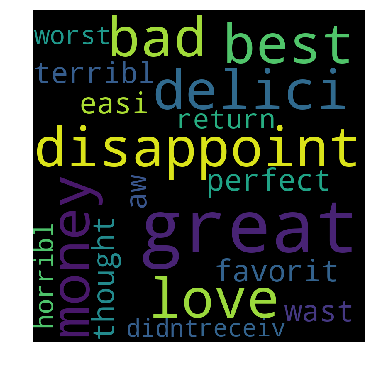

In [30]:
#Feature importance
indices = np.argsort(rf_optimal.feature_importances_)[::-1]

#Top 20 features
f=feature_names[indices[:20]]

sf = ""
for i in f:
    sf += str(i)+","

print("************ Top 20 Features *******************")
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='black', 
                min_font_size = 10).generate(sf) 
  
# plot the WordCloud image                        
plt.figure(figsize = (5,5), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.show()


In [31]:
#Confusion matrix
C = confusion_matrix(y_test, pred_bow)
A =(((C.T)/(C.sum(axis=1))).T)
B =(C/C.sum(axis=0))
labels = [0,1]

-------------------- Confusion matrix --------------------


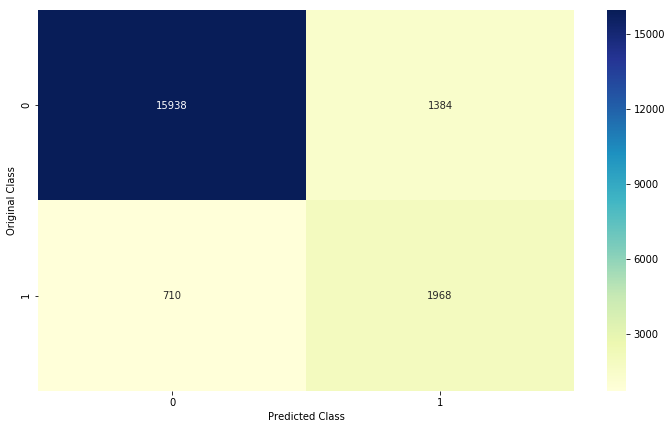

-------------------- Precision matrix (Columm Sum=1) --------------------


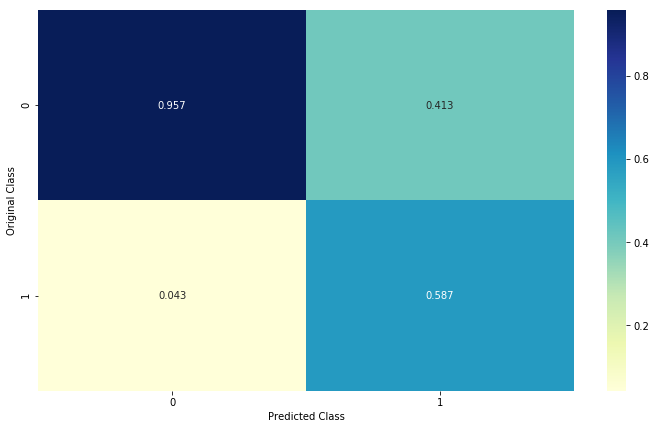

-------------------- Recall matrix (Row sum=1) --------------------


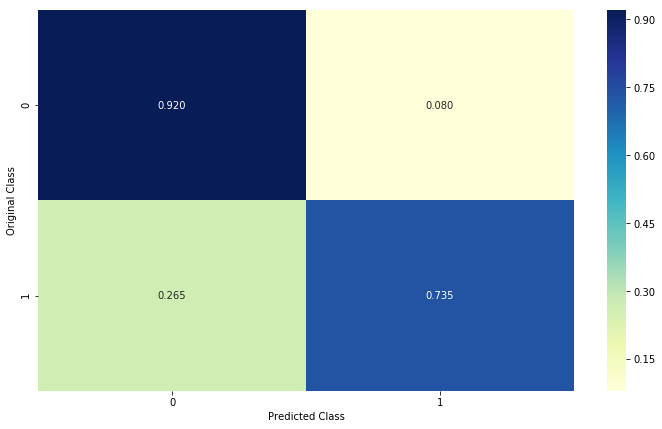

In [32]:
 print("-"*20, "Confusion matrix", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(C, annot=True, cmap="YlGnBu", fmt="g", xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()

print("-"*20, "Precision matrix (Columm Sum=1)", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(B, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels)
 plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()
    
    # representing B in heatmap format
print("-"*20, "Recall matrix (Row sum=1)", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(A, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()

#### Tf-idf

In [7]:
#Initiating Vectorizer
count_vect = TfidfVectorizer(ngram_range=(1,2))

#Train data
vocabulary = count_vect.fit(x_train)
Tfidf_x_train= count_vect.transform(x_train)
print("the type of count vectorizer ",type(Tfidf_x_train))
print("the shape of out text BOW vectorizer ",Tfidf_x_train.get_shape())
print("the number of unique words ", Tfidf_x_train.get_shape()[1])

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text BOW vectorizer  (80000, 1013943)
the number of unique words  1013943


In [8]:
#Test data
Tfidf_x_test= count_vect.transform(x_test)
print("the type of count vectorizer ",type(Tfidf_x_test))
print("the shape of out text BOW vectorizer ",Tfidf_x_test.get_shape())
print("the number of unique words ", Tfidf_x_test.get_shape()[1])

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text BOW vectorizer  (20000, 1013943)
the number of unique words  1013943


In [11]:
grid.fit(Tfidf_x_train, y_train)

# examine the best model
print(grid.best_score_)
print(grid.best_params_)

0.6376155281628649
{'n_estimators': 700, 'min_samples_split': 19, 'min_samples_leaf': 2, 'max_depth': 29, 'class_weight': 'balanced'}


Text(0,0.5,'Cross-Validated Error')

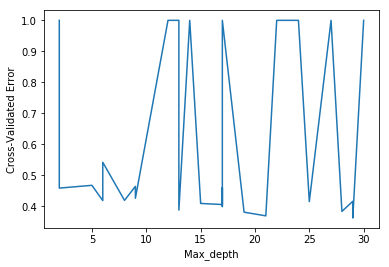

In [12]:
#Plotting Max_depth v/s CV_error
a=pd.DataFrame(grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]
a['max_depth'] = [d.get('max_depth') for d in a['params']]
b=a.sort_values(['max_depth'])
CV_Error=1-b['mean_test_score']
max_depth =b['max_depth']


plt.plot(max_depth,CV_Error)
plt.xlabel('Max_depth')
plt.ylabel('Cross-Validated Error')

In [13]:

#{'n_estimators': 700, 'min_samples_split': 19, 'min_samples_leaf': 2, 'max_depth': 29, 'class_weight': 'balanced'}
rf_optimal=RandomForestClassifier(n_estimators=700,min_samples_split=19,min_samples_leaf=2,max_depth=29,class_weight='balanced')

# fitting the model
rf_optimal.fit(Tfidf_x_train, y_train)

# predict the response
pred_tfidf = rf_optimal.predict(Tfidf_x_test)

# evaluate accuracy
f1_score = f1_score(y_test, pred_tfidf)

In [14]:
# Train & Test Error
print("The overall f1_score for the Train Data is : ", metrics.f1_score(y_train,rf_optimal.predict(Tfidf_x_train)))
print("The overall f1_score for the Test Data is : ", metrics.f1_score(y_test,pred_tfidf))

The overall f1_score for the Train Data is :  0.7166666666666666
The overall f1_score for the Test Data is :  0.6790557508789553


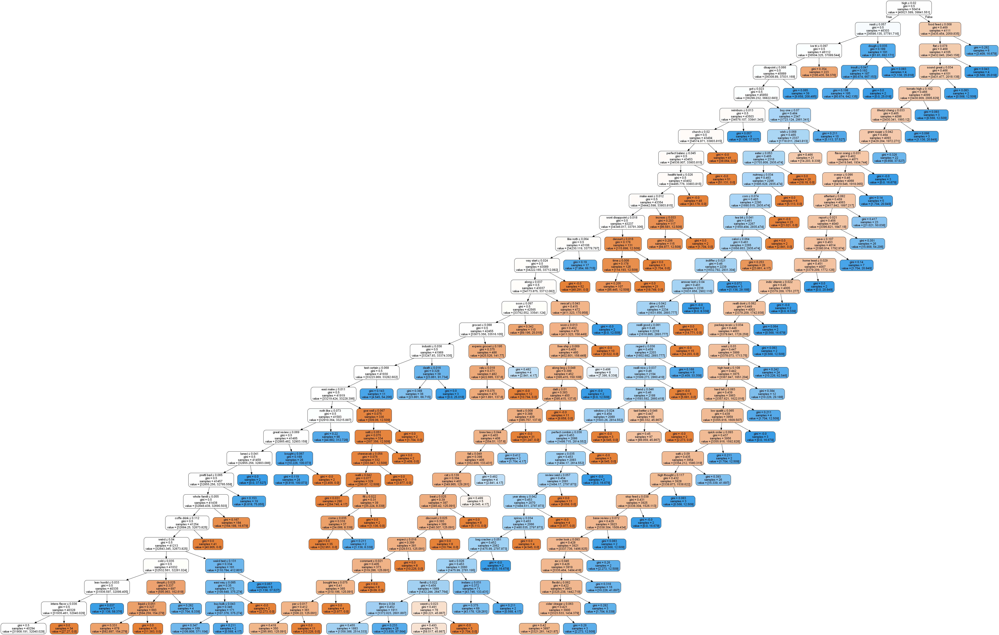

In [15]:
#Visualizing Tree
feature_names = np.array(vocabulary.get_feature_names())

from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(rf_optimal.estimators_[0], out_file=dot_data,
                feature_names=feature_names,
                filled=True, rounded=True,
                special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [16]:
# Saving DT as pdf
graph.write_pdf("Tfidf_random_forest.pdf")

True

************ Top 20 Features *******************


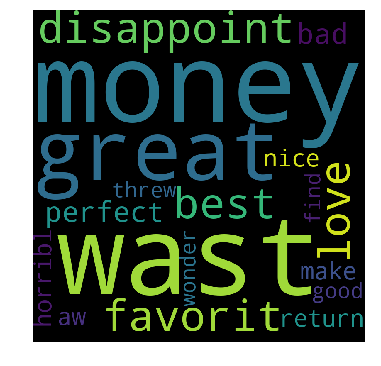

In [17]:
#Feature importance
indices = np.argsort(rf_optimal.feature_importances_)[::-1]

#Top 20 features
f=feature_names[indices[:20]]

sf = ""
for i in f:
    sf += str(i)+","

print("************ Top 20 Features *******************")
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='black', 
                min_font_size = 10).generate(sf) 
  
# plot the WordCloud image                        
plt.figure(figsize = (5,5), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.show()


In [18]:
#Confusion matrix
C = confusion_matrix(y_test, pred_tfidf)
A =(((C.T)/(C.sum(axis=1))).T)
B =(C/C.sum(axis=0))
labels = [0,1]

-------------------- Confusion matrix --------------------


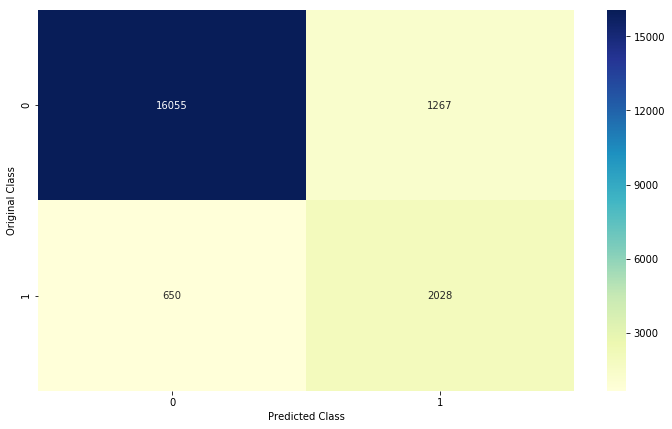

-------------------- Precision matrix (Columm Sum=1) --------------------


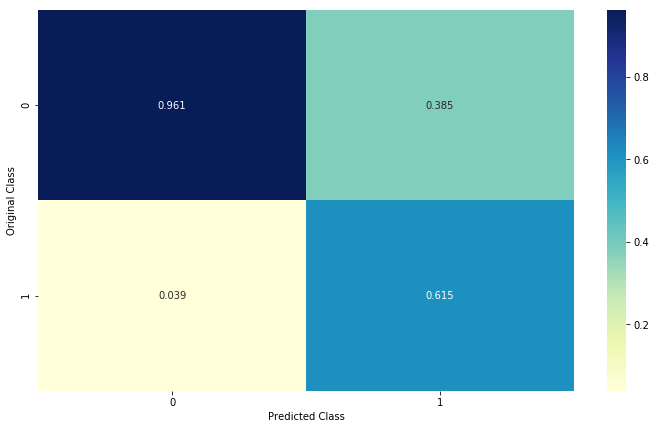

-------------------- Recall matrix (Row sum=1) --------------------


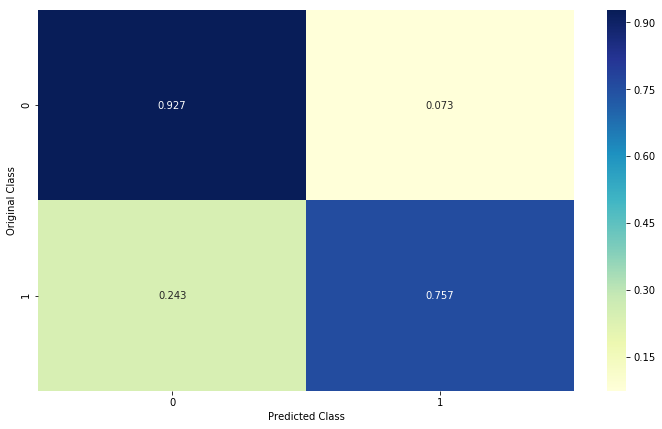

In [19]:
 print("-"*20, "Confusion matrix", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(C, annot=True, cmap="YlGnBu", fmt="g", xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()

print("-"*20, "Precision matrix (Columm Sum=1)", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(B, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels)
 plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()
    
    # representing B in heatmap format
print("-"*20, "Recall matrix (Row sum=1)", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(A, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()

#### Avg-W2Vec

In [44]:
#W2V list of Training data
i=0
list_of_sent_train=[]
for sent in train_data['CleanedText'].values:
    list_of_sent_train.append(sent.split())

In [45]:
#W2V List of Test data
i=0
list_of_sent_test=[]
for sent in test_data['CleanedText'].values:
    list_of_sent_test.append(sent.split())

In [46]:
#Training W2V train model
# min_count = 5 considers only words that occured atleast 5 times
w2v_model_train=Word2Vec(list_of_sent_train,min_count=5,size=200, workers=6)

In [47]:
w2v_words_train = list(w2v_model_train.wv.vocab)
print("number of words that occured minimum 5 times ",len(w2v_words_train))
print("sample words ", w2v_words_train[0:50])

number of words that occured minimum 5 times  11361
sample words  ['witti', 'littl', 'book', 'make', 'son', 'laugh', 'loud', 'car', 'drive', 'along', 'alway', 'sing', 'refrain', 'hes', 'learn', 'whale', 'india', 'droop', 'love', 'new', 'word', 'introduc', 'silli', 'classic', 'will', 'bet', 'still', 'abl', 'memori', 'colleg', 'rememb', 'see', 'show', 'air', 'televis', 'year', 'ago', 'child', 'sister', 'later', 'bought', 'day', 'thirti', 'someth', 'use', 'seri', 'song', 'student', 'teach', 'preschool']


In [48]:
#Train data
# average Word2Vec
# compute average word2vec for each review.
sent_vectors_train_avgw2v = []; # the avg-w2v for each sentence/review is stored in this list
for sent in list_of_sent_train: # for each review/sentence
    sent_vec = np.zeros(200) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words_train:
            vec = w2v_model_train.wv[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
    sent_vectors_train_avgw2v.append(sent_vec)
print(len(sent_vectors_train_avgw2v))
print(len(sent_vectors_train_avgw2v[0]))

80000
200


In [49]:
#Test data
# average Word2Vec
# compute average word2vec for each review.
sent_vectors_test_avgw2v = []; # the avg-w2v for each sentence/review is stored in this list
for sent in list_of_sent_test: # for each review/sentence
    sent_vec = np.zeros(200) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words_train:
            vec = w2v_model_train.wv[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
    sent_vectors_test_avgw2v.append(sent_vec)
print(len(sent_vectors_test_avgw2v))
print(len(sent_vectors_test_avgw2v[0]))

20000
200


In [50]:
grid.fit(sent_vectors_train_avgw2v, y_train)

# examine the best model
print(grid.best_score_)
print(grid.best_params_)

0.5603547709872246
{'n_estimators': 200, 'min_samples_split': 18, 'min_samples_leaf': 22, 'max_depth': 28, 'class_weight': 'balanced'}


Text(0,0.5,'Cross-Validated Error')

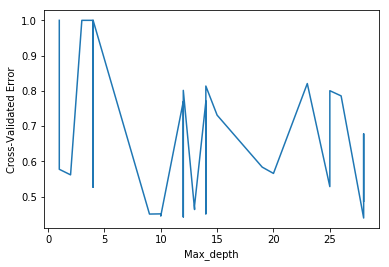

In [51]:
#Plotting Max_depth v/s CV_error
a=pd.DataFrame(grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]
a['max_depth'] = [d.get('max_depth') for d in a['params']]
b=a.sort_values(['max_depth'])
CV_Error=1-b['mean_test_score']
max_depth =b['max_depth']


plt.plot(max_depth,CV_Error)
plt.xlabel('Max_depth')
plt.ylabel('Cross-Validated Error')

In [53]:
#{'n_estimators': 200, 'min_samples_split': 18, 'min_samples_leaf': 22, 'max_depth': 28, 'class_weight': 'balanced'}
rf_optimal=RandomForestClassifier(n_estimators=200,min_samples_split=18,min_samples_leaf=22,max_depth=28,class_weight='balanced')

# fitting the model
rf_optimal.fit(sent_vectors_train_avgw2v, y_train)

# predict the response
pred_avg_w2v = rf_optimal.predict(sent_vectors_test_avgw2v)

# evaluate f1_score
f1_score = f1_score(y_test, pred_avg_w2v)

In [54]:
# Train & Test Error
print("The overall f1_score for the Train Data is : ", metrics.f1_score(y_train,rf_optimal.predict(sent_vectors_train_avgw2v)))
print("The overall f1_score for the Test Data is : ", metrics.f1_score(y_test,pred_avg_w2v))

The overall f1_score for the Train Data is :  0.7820834986553807
The overall f1_score for the Test Data is :  0.5968760385510136


In [59]:
#Increasing the parameter for grid search as RF is overfitting for the above parameters
n_estimators=list(range(100,1100,100))
max_depth=list(range(1,70,1))
min_samples_split=list(range(2,70,1))
min_samples_leaf=list(range(1,70,1))
weight=[None,'balanced']
T= TimeSeriesSplit(n_splits=5)

param_distributions = dict(n_estimators=n_estimators,max_depth=max_depth,min_samples_split=min_samples_split,min_samples_leaf=min_samples_leaf,class_weight=weight)
print(param_distributions)

# instantiate and fit the grid
grid = RandomizedSearchCV(RandomForestClassifier(), param_distributions, cv=T, scoring='f1', n_iter=30,return_train_score=False,n_jobs=-1)

{'n_estimators': [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000], 'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69], 'min_samples_split': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69], 'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69], 'class_weight': [None, 'balanced']}


In [60]:
#Re-fitting grid
grid.fit(sent_vectors_train_avgw2v, y_train)

# examine the best model
print(grid.best_score_)
print(grid.best_params_)

0.5614712464874515
{'n_estimators': 900, 'min_samples_split': 54, 'min_samples_leaf': 10, 'max_depth': 34, 'class_weight': 'balanced'}


Text(0,0.5,'Cross-Validated Error')

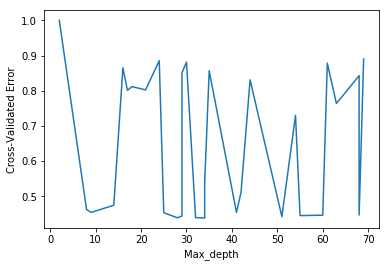

In [61]:
#Re-Plotting Max_depth v/s CV_error
a=pd.DataFrame(grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]
a['max_depth'] = [d.get('max_depth') for d in a['params']]
b=a.sort_values(['max_depth'])
CV_Error=1-b['mean_test_score']
max_depth =b['max_depth']


plt.plot(max_depth,CV_Error)
plt.xlabel('Max_depth')
plt.ylabel('Cross-Validated Error')

In [64]:
#{'n_estimators': 900, 'min_samples_split': 54, 'min_samples_leaf': 10, 'max_depth': 34, 'class_weight': 'balanced'}
rf_optimal=RandomForestClassifier(n_estimators=900,min_samples_split=54,min_samples_leaf=10,max_depth=34,class_weight='balanced',n_jobs=-1)

# fitting the model
rf_optimal.fit(sent_vectors_train_avgw2v, y_train)

# predict the response
pred_avg_w2v = rf_optimal.predict(sent_vectors_test_avgw2v)

# evaluate f1_score
f1_score = f1_score(y_test, pred_avg_w2v)

# Train & Test Error
print("The overall f1_score for the Train Data is : ", metrics.f1_score(y_train,rf_optimal.predict(sent_vectors_train_avgw2v)))
print("The overall f1_score for the Test Data is : ", metrics.f1_score(y_test,pred_avg_w2v))

The overall f1_score for the Train Data is :  0.8117551462621886
The overall f1_score for the Test Data is :  0.6002766251728908


Still Overfitting!

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.343675 to fit



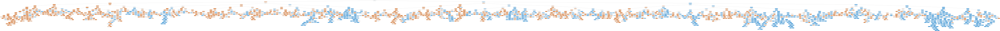

In [66]:
#Visualizing Tree
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(rf_optimal.estimators_[0], out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [67]:
# Saving DT as pdf
graph.write_pdf("Avg-W2V_random_forest.pdf")

True

In [68]:
#Confusion matrix
C = confusion_matrix(y_test, pred_avg_w2v)
A =(((C.T)/(C.sum(axis=1))).T)
B =(C/C.sum(axis=0))
labels = [0,1]

-------------------- Confusion matrix --------------------


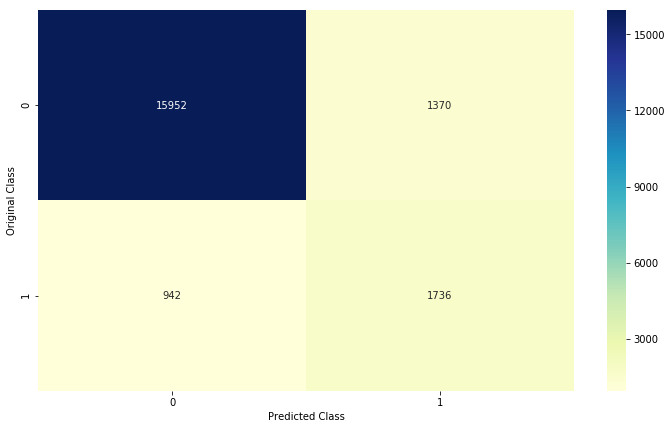

-------------------- Precision matrix (Columm Sum=1) --------------------


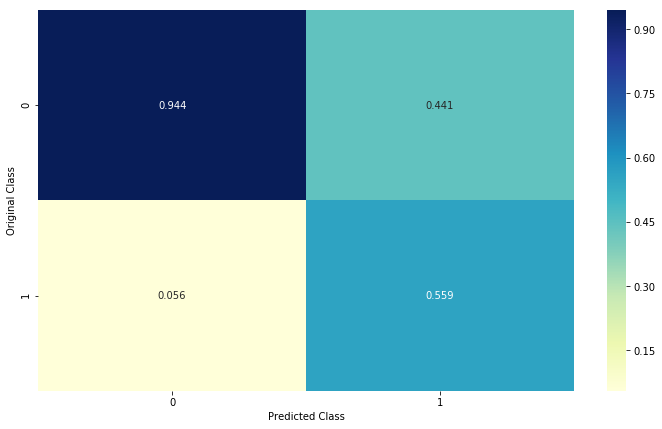

-------------------- Recall matrix (Row sum=1) --------------------


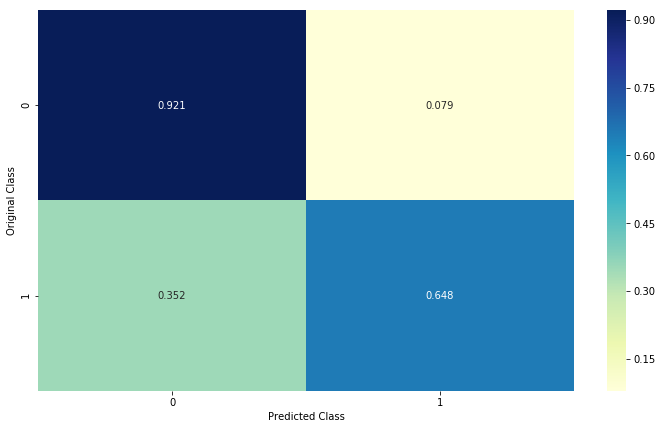

In [69]:
 print("-"*20, "Confusion matrix", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(C, annot=True, cmap="YlGnBu", fmt="g", xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()

print("-"*20, "Precision matrix (Columm Sum=1)", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(B, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels)
 plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()
    
    # representing B in heatmap format
print("-"*20, "Recall matrix (Row sum=1)", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(A, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()

#### Tfidf-W2V

Importing Pre-featurized pickle file

In [70]:
#Train
with open('train.pickle', 'rb') as f:
   tfidf_w2v_sent_vectors_train = pickle.load(f)

In [71]:
#Test
with open('test.pickle', 'rb') as f:
    tfidf_w2v_sent_vectors_test = pickle.load(f)

In [72]:
grid.fit(tfidf_w2v_sent_vectors_train, y_train)

# examine the best model
print(grid.best_score_)
print(grid.best_params_)

0.5004314284442454
{'n_estimators': 500, 'min_samples_split': 9, 'min_samples_leaf': 40, 'max_depth': 61, 'class_weight': 'balanced'}


Text(0,0.5,'Cross-Validated Error')

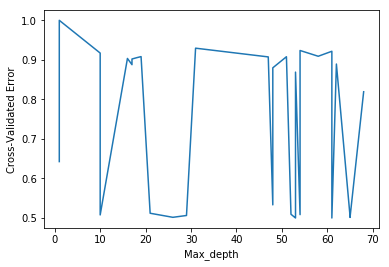

In [73]:
#Re-Plotting Max_depth v/s CV_error
a=pd.DataFrame(grid.cv_results_)[['mean_test_score', 'std_test_score', 'params']]
a['max_depth'] = [d.get('max_depth') for d in a['params']]
b=a.sort_values(['max_depth'])
CV_Error=1-b['mean_test_score']
max_depth =b['max_depth']


plt.plot(max_depth,CV_Error)
plt.xlabel('Max_depth')
plt.ylabel('Cross-Validated Error')

In [74]:
#{'n_estimators': 500, 'min_samples_split': 9, 'min_samples_leaf': 40, 'max_depth': 61, 'class_weight': 'balanced'}
rf_optimal=RandomForestClassifier(n_estimators=500,min_samples_split=9,min_samples_leaf=40,max_depth=61,class_weight='balanced',n_jobs=-1)

# fitting the model
rf_optimal.fit(tfidf_w2v_sent_vectors_train, y_train)

# predict the response
pred_tfidf_w2v = rf_optimal.predict(tfidf_w2v_sent_vectors_test)

# evaluate f1_score
f1_score = f1_score(y_test, pred_tfidf_w2v)

# Train & Test Error
print("The overall f1_score for the Train Data is : ", metrics.f1_score(y_train,rf_optimal.predict(tfidf_w2v_sent_vectors_train)))
print("The overall f1_score for the Test Data is : ", metrics.f1_score(y_test,pred_tfidf_w2v))

The overall f1_score for the Train Data is :  0.6704789714888266
The overall f1_score for the Test Data is :  0.5303145418629387


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.385073 to fit



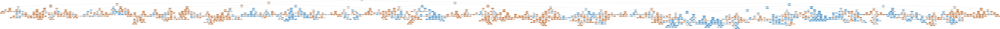

In [75]:
#Visualizing Tree
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(rf_optimal.estimators_[0], out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [76]:
# Saving DT as pdf
graph.write_pdf("Tfidf-W2V_random_forest.pdf")

True

In [77]:
#Confusion matrix
C = confusion_matrix(y_test, pred_tfidf_w2v)
A =(((C.T)/(C.sum(axis=1))).T)
B =(C/C.sum(axis=0))
labels = [0,1]

-------------------- Confusion matrix --------------------


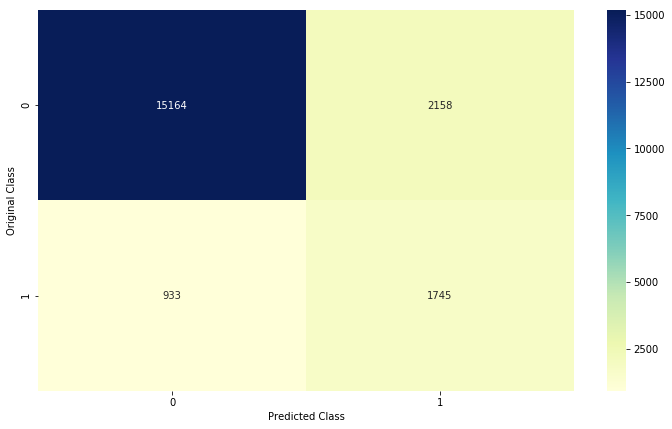

-------------------- Precision matrix (Columm Sum=1) --------------------


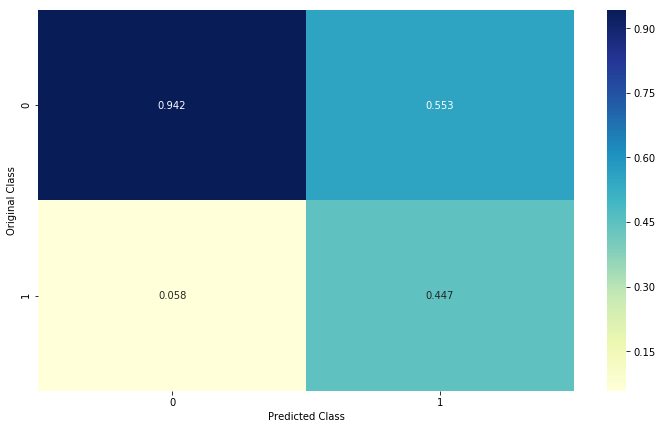

-------------------- Recall matrix (Row sum=1) --------------------


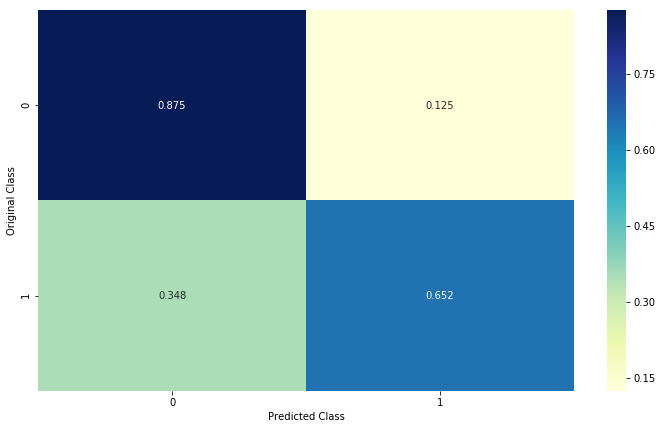

In [78]:
 print("-"*20, "Confusion matrix", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(C, annot=True, cmap="YlGnBu", fmt="g", xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()

print("-"*20, "Precision matrix (Columm Sum=1)", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(B, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels)
 plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()
    
    # representing B in heatmap format
print("-"*20, "Recall matrix (Row sum=1)", "-"*20)
plt.figure(figsize=(12,7))
sns.heatmap(A, annot=True, cmap="YlGnBu", fmt=".3f", xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted Class')
plt.ylabel('Original Class')
plt.show()

***********************************************************************************************************************************